In [1]:
# import neptune.new as neptune
# from neptune.new.types import File

# run = neptune.init(
#     project="arsde/J21-BDT",
#     tags=["xgb", "5M", "MSE", "all features"],
#     run='JBDT-4'
# )

In [2]:
import pandas as pd
import numpy as np
from tqdm.notebook import tqdm

import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.io as pio

from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
import pickle
import eli5
import shap
from eli5.sklearn import PermutationImportance

import warnings
warnings.filterwarnings("ignore")

In [3]:
train = input()
if train.lower()=='yes':
    train=True
else:
    train=False

yes


In [4]:
vm = input()
if vm.lower()=='yes':
    vm=True
else:
    vm=False

yes


In [5]:
bdt_J19 = pd.read_csv('df_bdt_eval.csv')
bdt_J19_5M_23 = bdt_J19[(bdt_J19['opt']==23) & (bdt_J19['model']=='5M')]
bdt_J19_5M_0 = bdt_J19[(bdt_J19['opt']==0) & (bdt_J19['model']=='5M')]

In [6]:
if vm:
    path='/mnt/cephfs/ml_data/mc_2021/'
else:
    path=''

data_ideal = pd.read_csv('{}processed_data/ProcessedTrainIdeal/ProcessedTrain.csv.gz'.format(path))
data_ideal = data_ideal[data_ideal['edepR'] < 17.2]

data_real = pd.read_csv('{}processed_data/ProcessedTrainReal/ProcessedTrain.csv.gz'.format(path))
data_real = data_real[data_real['edepR'] < 17.2]

In [7]:
all_data = [data_ideal, data_real]

In [8]:
from sklearn.model_selection import train_test_split

X_trains = []
y_trains = []

X_vals = []
y_vals = []

for i in range(len(all_data)):
    X = all_data[i].iloc[:, :-5]
    y = all_data[i].iloc[:, -1]
    
    X_train, X_val, y_train, y_val = train_test_split(
        X, y, test_size=0.1, random_state=22)
    
    X_trains.append(X_train)
    y_trains.append(y_train)
    
    X_vals.append(X_val)
    y_vals.append(y_val)

In [9]:
# from neptune.new.integrations.lightgbm import NeptuneCallback
# from neptune.new.integrations.xgboost import NeptuneCallback
# neptune_callback = NeptuneCallback(run=run)

models = []
if train:
    for i in tqdm(range(len(all_data))):
        model = XGBRegressor(
                max_depth=11,
#                 objective='mape',
                learning_rate=0.08,
                n_estimators=3000,
                random_state=22,
                tree_method='gpu_hist'
        )

        model.fit(X_trains[i], y_trains[i], verbose=True,
                   eval_set=[(X_vals[i], y_vals[i])],
                   eval_metric=['rmse'],
#                    callbacks=[neptune_callback],
                   early_stopping_rounds=7)
        
        models.append(model)
        if i == 0:
            option = 'ideal'
        elif i == 1:
            option = 'real'
            
#         pickle.dump(model, open("models/xgb_energy_{}_5M_rmse.dat".format(option), "wb"))
#         run['output/model_checkpoints/xgb_energy_{}_5M_rmse.dat'.format(option)].upload(
#             '/home/arsde/J21_SYSU/models/xgb_energy_{}_5M_rmse.dat'.format(option)
#         )

  0%|          | 0/2 [00:00<?, ?it/s]

[0]	validation_0-rmse:11.81591
[1]	validation_0-rmse:10.87094
[2]	validation_0-rmse:10.00160
[3]	validation_0-rmse:9.20179
[4]	validation_0-rmse:8.46596
[5]	validation_0-rmse:7.78902
[6]	validation_0-rmse:7.16625
[7]	validation_0-rmse:6.59330
[8]	validation_0-rmse:6.06620
[9]	validation_0-rmse:5.58127
[10]	validation_0-rmse:5.13514
[11]	validation_0-rmse:4.72471
[12]	validation_0-rmse:4.34715
[13]	validation_0-rmse:3.99979
[14]	validation_0-rmse:3.68023
[15]	validation_0-rmse:3.38625
[16]	validation_0-rmse:3.11582
[17]	validation_0-rmse:2.86704
[18]	validation_0-rmse:2.63820
[19]	validation_0-rmse:2.42768
[20]	validation_0-rmse:2.23402
[21]	validation_0-rmse:2.05591
[22]	validation_0-rmse:1.89205
[23]	validation_0-rmse:1.74134
[24]	validation_0-rmse:1.60272
[25]	validation_0-rmse:1.47523
[26]	validation_0-rmse:1.35797
[27]	validation_0-rmse:1.25016
[28]	validation_0-rmse:1.15102
[29]	validation_0-rmse:1.05987
[30]	validation_0-rmse:0.97609
[31]	validation_0-rmse:0.89907
[32]	validation

[260]	validation_0-rmse:0.08491
[261]	validation_0-rmse:0.08487
[262]	validation_0-rmse:0.08484
[263]	validation_0-rmse:0.08480
[264]	validation_0-rmse:0.08478
[265]	validation_0-rmse:0.08476
[266]	validation_0-rmse:0.08473
[267]	validation_0-rmse:0.08471
[268]	validation_0-rmse:0.08466
[269]	validation_0-rmse:0.08464
[270]	validation_0-rmse:0.08461
[271]	validation_0-rmse:0.08460
[272]	validation_0-rmse:0.08457
[273]	validation_0-rmse:0.08453
[274]	validation_0-rmse:0.08450
[275]	validation_0-rmse:0.08447
[276]	validation_0-rmse:0.08445
[277]	validation_0-rmse:0.08441
[278]	validation_0-rmse:0.08439
[279]	validation_0-rmse:0.08436
[280]	validation_0-rmse:0.08434
[281]	validation_0-rmse:0.08431
[282]	validation_0-rmse:0.08428
[283]	validation_0-rmse:0.08426
[284]	validation_0-rmse:0.08424
[285]	validation_0-rmse:0.08422
[286]	validation_0-rmse:0.08420
[287]	validation_0-rmse:0.08418
[288]	validation_0-rmse:0.08416
[289]	validation_0-rmse:0.08414
[290]	validation_0-rmse:0.08411
[291]	va

[517]	validation_0-rmse:0.08118
[518]	validation_0-rmse:0.08117
[519]	validation_0-rmse:0.08117
[520]	validation_0-rmse:0.08116
[521]	validation_0-rmse:0.08115
[522]	validation_0-rmse:0.08114
[523]	validation_0-rmse:0.08114
[524]	validation_0-rmse:0.08114
[525]	validation_0-rmse:0.08113
[526]	validation_0-rmse:0.08112
[527]	validation_0-rmse:0.08111
[528]	validation_0-rmse:0.08111
[529]	validation_0-rmse:0.08110
[530]	validation_0-rmse:0.08110
[531]	validation_0-rmse:0.08109
[532]	validation_0-rmse:0.08108
[533]	validation_0-rmse:0.08108
[534]	validation_0-rmse:0.08107
[535]	validation_0-rmse:0.08106
[536]	validation_0-rmse:0.08106
[537]	validation_0-rmse:0.08105
[538]	validation_0-rmse:0.08105
[539]	validation_0-rmse:0.08104
[540]	validation_0-rmse:0.08103
[541]	validation_0-rmse:0.08102
[542]	validation_0-rmse:0.08102
[543]	validation_0-rmse:0.08101
[544]	validation_0-rmse:0.08100
[545]	validation_0-rmse:0.08099
[546]	validation_0-rmse:0.08099
[547]	validation_0-rmse:0.08098
[548]	va

[774]	validation_0-rmse:0.08017
[775]	validation_0-rmse:0.08017
[776]	validation_0-rmse:0.08016
[777]	validation_0-rmse:0.08016
[778]	validation_0-rmse:0.08016
[779]	validation_0-rmse:0.08016
[780]	validation_0-rmse:0.08016
[781]	validation_0-rmse:0.08015
[782]	validation_0-rmse:0.08015
[783]	validation_0-rmse:0.08015
[784]	validation_0-rmse:0.08015
[785]	validation_0-rmse:0.08014
[786]	validation_0-rmse:0.08014
[787]	validation_0-rmse:0.08014
[788]	validation_0-rmse:0.08014
[789]	validation_0-rmse:0.08013
[790]	validation_0-rmse:0.08013
[791]	validation_0-rmse:0.08013
[792]	validation_0-rmse:0.08013
[793]	validation_0-rmse:0.08013
[794]	validation_0-rmse:0.08013
[795]	validation_0-rmse:0.08012
[796]	validation_0-rmse:0.08012
[797]	validation_0-rmse:0.08012
[798]	validation_0-rmse:0.08012
[799]	validation_0-rmse:0.08011
[800]	validation_0-rmse:0.08011
[801]	validation_0-rmse:0.08011
[802]	validation_0-rmse:0.08011
[803]	validation_0-rmse:0.08011
[804]	validation_0-rmse:0.08011
[805]	va

[1030]	validation_0-rmse:0.07976
[1031]	validation_0-rmse:0.07976
[1032]	validation_0-rmse:0.07975
[1033]	validation_0-rmse:0.07975
[1034]	validation_0-rmse:0.07975
[1035]	validation_0-rmse:0.07975
[1036]	validation_0-rmse:0.07975
[1037]	validation_0-rmse:0.07975
[1038]	validation_0-rmse:0.07975
[1039]	validation_0-rmse:0.07975
[1040]	validation_0-rmse:0.07975
[1041]	validation_0-rmse:0.07975
[1042]	validation_0-rmse:0.07975
[1043]	validation_0-rmse:0.07975
[1044]	validation_0-rmse:0.07974
[1045]	validation_0-rmse:0.07974
[1046]	validation_0-rmse:0.07974
[1047]	validation_0-rmse:0.07974
[1048]	validation_0-rmse:0.07974
[1049]	validation_0-rmse:0.07974
[1050]	validation_0-rmse:0.07974
[1051]	validation_0-rmse:0.07974
[1052]	validation_0-rmse:0.07974
[1053]	validation_0-rmse:0.07974
[1054]	validation_0-rmse:0.07974
[1055]	validation_0-rmse:0.07974
[1056]	validation_0-rmse:0.07974
[1057]	validation_0-rmse:0.07973
[1058]	validation_0-rmse:0.07973
[1059]	validation_0-rmse:0.07973
[1060]	val

[1279]	validation_0-rmse:0.07956
[1280]	validation_0-rmse:0.07956
[1281]	validation_0-rmse:0.07956
[1282]	validation_0-rmse:0.07956
[1283]	validation_0-rmse:0.07956
[1284]	validation_0-rmse:0.07956
[1285]	validation_0-rmse:0.07956
[1286]	validation_0-rmse:0.07956
[1287]	validation_0-rmse:0.07956
[1288]	validation_0-rmse:0.07956
[1289]	validation_0-rmse:0.07956
[1290]	validation_0-rmse:0.07956
[1291]	validation_0-rmse:0.07956
[1292]	validation_0-rmse:0.07956
[1293]	validation_0-rmse:0.07956
[1294]	validation_0-rmse:0.07956
[1295]	validation_0-rmse:0.07955
[1296]	validation_0-rmse:0.07955
[1297]	validation_0-rmse:0.07955
[1298]	validation_0-rmse:0.07955
[1299]	validation_0-rmse:0.07955
[1300]	validation_0-rmse:0.07955
[1301]	validation_0-rmse:0.07955
[1302]	validation_0-rmse:0.07955
[1303]	validation_0-rmse:0.07955
[1304]	validation_0-rmse:0.07955
[1305]	validation_0-rmse:0.07955
[1306]	validation_0-rmse:0.07955
[1307]	validation_0-rmse:0.07955
[1308]	validation_0-rmse:0.07955
[1309]	val

[6]	validation_0-rmse:7.16721
[7]	validation_0-rmse:6.59433
[8]	validation_0-rmse:6.06727
[9]	validation_0-rmse:5.58239
[10]	validation_0-rmse:5.13631
[11]	validation_0-rmse:4.72591
[12]	validation_0-rmse:4.34837
[13]	validation_0-rmse:4.00107
[14]	validation_0-rmse:3.68156
[15]	validation_0-rmse:3.38762
[16]	validation_0-rmse:3.11722
[17]	validation_0-rmse:2.86849
[18]	validation_0-rmse:2.63967
[19]	validation_0-rmse:2.42919
[20]	validation_0-rmse:2.23558
[21]	validation_0-rmse:2.05751
[22]	validation_0-rmse:1.89372
[23]	validation_0-rmse:1.74307
[24]	validation_0-rmse:1.60452
[25]	validation_0-rmse:1.47711
[26]	validation_0-rmse:1.35994
[27]	validation_0-rmse:1.25221
[28]	validation_0-rmse:1.15315
[29]	validation_0-rmse:1.06212
[30]	validation_0-rmse:0.97843
[31]	validation_0-rmse:0.90151
[32]	validation_0-rmse:0.83085
[33]	validation_0-rmse:0.76593
[34]	validation_0-rmse:0.70632
[35]	validation_0-rmse:0.65159
[36]	validation_0-rmse:0.60138
[37]	validation_0-rmse:0.55532
[38]	validat

[266]	validation_0-rmse:0.09864
[267]	validation_0-rmse:0.09862
[268]	validation_0-rmse:0.09859
[269]	validation_0-rmse:0.09856
[270]	validation_0-rmse:0.09855
[271]	validation_0-rmse:0.09853
[272]	validation_0-rmse:0.09852
[273]	validation_0-rmse:0.09849
[274]	validation_0-rmse:0.09848
[275]	validation_0-rmse:0.09844
[276]	validation_0-rmse:0.09842
[277]	validation_0-rmse:0.09840
[278]	validation_0-rmse:0.09839
[279]	validation_0-rmse:0.09838
[280]	validation_0-rmse:0.09836
[281]	validation_0-rmse:0.09835
[282]	validation_0-rmse:0.09833
[283]	validation_0-rmse:0.09830
[284]	validation_0-rmse:0.09828
[285]	validation_0-rmse:0.09827
[286]	validation_0-rmse:0.09825
[287]	validation_0-rmse:0.09823
[288]	validation_0-rmse:0.09822
[289]	validation_0-rmse:0.09821
[290]	validation_0-rmse:0.09818
[291]	validation_0-rmse:0.09815
[292]	validation_0-rmse:0.09814
[293]	validation_0-rmse:0.09811
[294]	validation_0-rmse:0.09809
[295]	validation_0-rmse:0.09807
[296]	validation_0-rmse:0.09804
[297]	va

[523]	validation_0-rmse:0.09568
[524]	validation_0-rmse:0.09568
[525]	validation_0-rmse:0.09568
[526]	validation_0-rmse:0.09567
[527]	validation_0-rmse:0.09566
[528]	validation_0-rmse:0.09566
[529]	validation_0-rmse:0.09564
[530]	validation_0-rmse:0.09564
[531]	validation_0-rmse:0.09563
[532]	validation_0-rmse:0.09563
[533]	validation_0-rmse:0.09562
[534]	validation_0-rmse:0.09562
[535]	validation_0-rmse:0.09561
[536]	validation_0-rmse:0.09560
[537]	validation_0-rmse:0.09560
[538]	validation_0-rmse:0.09560
[539]	validation_0-rmse:0.09560
[540]	validation_0-rmse:0.09559
[541]	validation_0-rmse:0.09559
[542]	validation_0-rmse:0.09558
[543]	validation_0-rmse:0.09558
[544]	validation_0-rmse:0.09557
[545]	validation_0-rmse:0.09556
[546]	validation_0-rmse:0.09556
[547]	validation_0-rmse:0.09555
[548]	validation_0-rmse:0.09555
[549]	validation_0-rmse:0.09554
[550]	validation_0-rmse:0.09554
[551]	validation_0-rmse:0.09553
[552]	validation_0-rmse:0.09553
[553]	validation_0-rmse:0.09552
[554]	va

[780]	validation_0-rmse:0.09485
[781]	validation_0-rmse:0.09485
[782]	validation_0-rmse:0.09484
[783]	validation_0-rmse:0.09484
[784]	validation_0-rmse:0.09484
[785]	validation_0-rmse:0.09484
[786]	validation_0-rmse:0.09484
[787]	validation_0-rmse:0.09483
[788]	validation_0-rmse:0.09483
[789]	validation_0-rmse:0.09483
[790]	validation_0-rmse:0.09483
[791]	validation_0-rmse:0.09483
[792]	validation_0-rmse:0.09483
[793]	validation_0-rmse:0.09483
[794]	validation_0-rmse:0.09482
[795]	validation_0-rmse:0.09482
[796]	validation_0-rmse:0.09482
[797]	validation_0-rmse:0.09481
[798]	validation_0-rmse:0.09481
[799]	validation_0-rmse:0.09481
[800]	validation_0-rmse:0.09481
[801]	validation_0-rmse:0.09481
[802]	validation_0-rmse:0.09481
[803]	validation_0-rmse:0.09480
[804]	validation_0-rmse:0.09480
[805]	validation_0-rmse:0.09480
[806]	validation_0-rmse:0.09480
[807]	validation_0-rmse:0.09480
[808]	validation_0-rmse:0.09480
[809]	validation_0-rmse:0.09480
[810]	validation_0-rmse:0.09479
[811]	va

In [10]:
# models = []
# perms = []

# models.append(pickle.load(open("models/xgb_energy_ideal_5M_rmse.dat", "rb")))
# perms.append(PermutationImportance(xgbregs[0], random_state=1).fit(X_vals[0], y_vals[0]))

# models.append(pickle.load(open("models/xgb_energy_real_5M_rmse.dat", "rb")))
# perms.append(PermutationImportance(xgbregs[1], random_state=1).fit(X_vals[1], y_vals[1]))

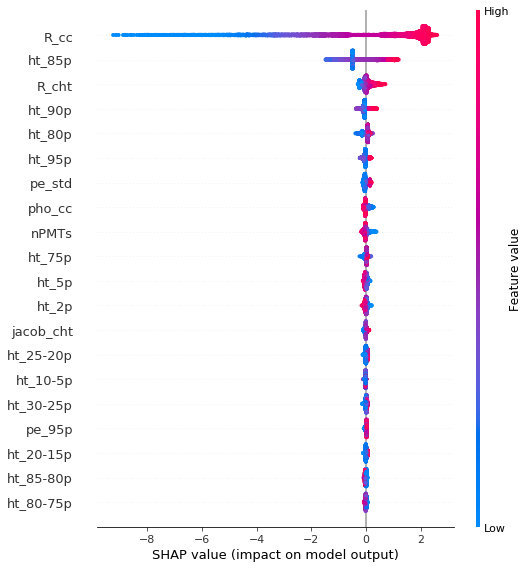

In [11]:
shap_values = shap.TreeExplainer(models[0]).shap_values(X_vals[0][:5000])
shap.summary_plot(shap_values, X_vals[0][:5000])

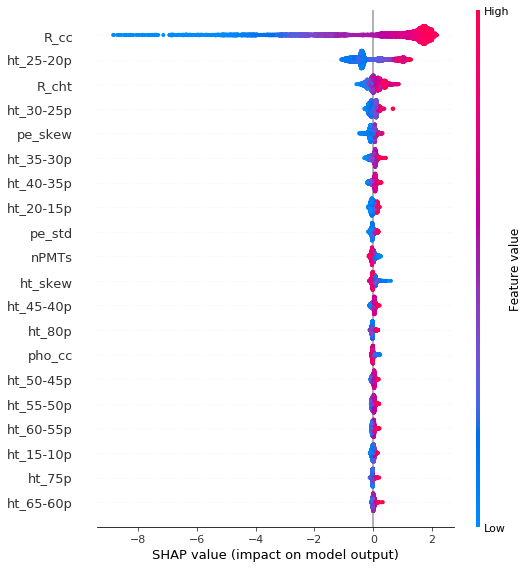

In [12]:
shap_values = shap.TreeExplainer(models[1]).shap_values(X_vals[1][:5000])
shap.summary_plot(shap_values, X_vals[1][:5000])

In [13]:
# eli5.show_weights(perms[0], feature_names=X.columns.tolist(), top=15)
# eli5.show_prediction(xgbregs[0], X_vals[0].iloc[100], show_feature_values=True, feature_names=X.columns.tolist())

In [14]:
# eli5.show_weights(perms[1], feature_names=X.columns.tolist(), top=15)

In [15]:
%%time
energies = [0, 0.1, 0.3, 0.6] + list(range(1, 11))
y_true_array = []
y_pred_array = []
for j in range(len(all_data)):
    if j == 0:
        name = 'ProcessedTestIdeal'
    elif j == 1:
        name = 'ProcessedTestReal'
    y_true = []
    y_pred = []
    for energy in energies:
        test = pd.read_csv('{}processed_data/{}/{}MeV.csv.gz'.format(path, name, energy))
        test = test[test['edepR'] < 17.2]
        edep = np.array(test['edepR'])
        X_test = test.iloc[:, :-5]
        edep_preds = models[j].predict(np.array(X_test))

        y_true.append(edep)
        y_pred.append(edep_preds)
    y_true_array.append(y_true)
    y_pred_array.append(y_pred)

CPU times: user 8min 12s, sys: 2.46 s, total: 8min 14s
Wall time: 2min 33s


In [16]:
pio.templates.default = 'plotly_dark'

def plot_predicts(y_pred, y_true, title='', size=10000):
    fig = go.Figure()

    for i in range(len(y_pred)):
        fig.add_trace(
            go.Scattergl(
                x=list(range(y_true[i][:size].shape[0])),
                y=y_pred[i][:size],
                mode='markers',
                opacity=0.75,
                marker=dict(
                    size=3,
                    color='rgb(255, {}, {})'.format(255-i*15, 5*i+10)
                ),
                name='{}MeVXGB'.format(i+1)
            )
        )
        fig.add_trace(
            go.Scattergl(
                x=list(range(y_true[i][:size].shape[0])),
                y=y_true[i][:size],
                mode='markers',
                opacity=0.75,
                marker=dict(
                    size=3,
                    color='rgb(15, {}, {})'.format(100-i*5, 25*i+10)
                ),
                name='{}MeV'.format(i+1)
            )
        )

    fig.update_layout(
        title = title,
        showlegend=False,
        yaxis_title="Energy, MeV",
        xaxis_title="x",
        font=dict(
            family="Times New Roman",
            size=16,
            color="White"
        ),
        xaxis = dict(
            showline=True,
            ticks='outside',
            mirror=True,
            linecolor='black',
            showgrid=True,
            gridcolor='grey',
            gridwidth=0.25,
        ),
        yaxis = dict(
            showline=True,
            ticks='outside',
            mirror=True,
            linecolor='black',
            showgrid=True,
            gridcolor='grey',
            gridwidth=0.25,
            dtick=1,
            zeroline=True,
            zerolinecolor='black',
            zerolinewidth=0.25
            ),
    )

    fig.show()
#     pio.write_image(fig, 'plots/plot_predictions_{}_5M.pdf'.format(title.split(', ')[0]), width=900, height=600)
#     run['output/plot_predictions_{}_5M.pdf'.format(title.split(', ')[0])].upload(File.as_html(fig))

In [17]:
# plot_predicts(y_pred_array[0], y_true_array[0], title='Ideal, 500k')
# plot_predicts(y_pred_array[1], y_true_array[1], title='Real, 5M', size=5000)

In [18]:
diffs = np.array([
    [y_pred_array[j][i] - y_true_array[j][i] for i in range(len(y_pred_array[0]))]
    for j in range(len(y_pred_array))
])

In [19]:
energies = [0, 0.1, 0.3, 0.6] + list(range(1, 11))
energies = np.array([1.022+i for i in energies]).round(5)
energies

array([ 1.022,  1.122,  1.322,  1.622,  2.022,  3.022,  4.022,  5.022,
        6.022,  7.022,  8.022,  9.022, 10.022, 11.022])

In [20]:
names = ['Elecsim 5M Ideal', 'Elecsim 5M Real']

In [36]:
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.stats import norm

a_array = []
errors_array = []
for k in range(diffs.shape[0]):
    a = []
    e = []
    for i in range(diffs.shape[1]):
        fig, ax = plt.subplots()
        nbins = 150
        n, bins, patches = ax.hist(diffs[k][i], nbins, density=True, facecolor = 'grey', alpha = 0.5, label='before');
        plt.close(fig)
        centers = (0.5*(bins[1:]+bins[:-1]))
        pars, cov = curve_fit(lambda x, mu, sig : norm.pdf(x, loc=mu, scale=sig), centers, n, p0=[0,1])  
        a.append(pars)
        e.append(cov)
    a_array.append(a)
    errors_array.append(e)

In [37]:
pio.templates.default = 'plotly_white'

from scipy import stats
for k in range(2):
    fig = go.Figure()

    for i in range(len(diffs[k])): 
        x = np.linspace(diffs[k][i][:22500].min(), diffs[k][i][:22500].max(), 100)
        p = stats.norm.pdf(x, a_array[k][i][0], a_array[k][i][1])

        fig.add_trace(go.Scattergl(x=x,
                     y=p, mode='lines', name='mu={:.3f} +- {:.3f}, sigma={:.3f} +- {:.3f}'.format(
                         a_array[k][i][0], np.sqrt(errors_array[k][i][0][0]),
                         a_array[k][i][1], np.sqrt(errors_array[k][i][1][1])),
                        visible = (i==0)
                    ))

    for i in range(len(diffs[k])): 
        fig.add_trace(go.Histogram(x=diffs[k][i][:22500], xbins=dict(size=0.005),
                      showlegend=False, histnorm='probability density',
                     visible = (i==0)
                    ))

    buttons = []
    for N in range(0, len(diffs[k])): 
        buttons.append(
            dict(
                 args=['visible', [False]*N + [True] + [False]*(len(diffs[k])-1-N)],
                     label='Energy =  {} MeV'.format(energies[N]),
                 method='restyle'
            )
        )
        
    fig.update_layout(

        xaxis = dict(
            showline=True,
            ticks='outside',
            mirror=True,
            linecolor='black',
            showgrid=True,
            gridcolor='grey',
            gridwidth=0.25,
        ),

        yaxis = dict(
            showline=True,
            ticks='outside',
            mirror=True,
            linecolor='black',
            tick0=0,
#             dtick=1,
            showgrid=True,
            gridcolor='grey',
            gridwidth=0.25,
            zeroline=True,
            zerolinecolor='black',
            zerolinewidth=0.25
            ),
    )

    fig.update_layout(
        title = '{}'.format(names[k]),
        xaxis_title=r"$$E_{rec} - E_{true}$$",
        showlegend=True,
        updatemenus=list([
            dict(
                x=0.5,
                y=1.2,
                yanchor='top',
                buttons=buttons
            ),
        ]),
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=1.05,
            xanchor="right",
            x=1
        )
    )
    
    fig.show()
#     run['output/Result_distributions.pdf'].upload(File.as_html(fig))

In [42]:
def plot_results(appr=False):
    
#     y_lin = lambda x: np.sqrt(2.57**2 / x + 0.73**2 + (1.25 / x)**2)
    fig = make_subplots(rows=2, cols=1,
                        shared_xaxes=True,
                        vertical_spacing=0.01,
                        row_width=[0.25, 0.75]
    )

    for k in range(diffs.shape[0]):
        fig.add_trace(
            go.Scatter(
                x=energies,
                y=res[k],
                mode='markers',
                marker=dict(
                    color=colors[k],
                    symbol=symbols[k]
                ),
                showlegend=True,
                error_y=dict(
                    type='data',
                    width=10,
                    array=error_sigma[k],
                    visible=True
                ),
                name=names[k]
            ), row=1, col=1
        )

        fig.add_trace(
            go.Scatter(
                x=energies,
                y=bias[k],
                mode='markers',
                showlegend=False,
                marker=dict(
                    color=colors[k],
                    symbol=symbols[k]
                ),
                error_y=dict(
                        type='data',
                        width=10,
                        array=error_mu[k],
                        visible=True
                ),
                name=names[k]
            ), row=2, col=1
        )

    if appr:
        for k in range(len(names)):
            fig.add_trace(
                go.Scatter(
                    x=x_lin,
                    y=func(x_lin, a[k], b[k], c[k]),
                    mode='lines',
                    line=dict(
                    ),
                    opacity=0.5,
                    showlegend=False,
                    name=names[k],
                    marker=dict(
                        color=colors[k]
                    )
                ), row=1, col=1
            )

    xaxis = dict(
        showline=True,
        ticks='outside',
        mirror=True,
        tick0=1,
        dtick=1,
        linecolor='black',
        showgrid=True,
        gridcolor='grey',
        gridwidth=0.25,
    )

    yaxis = lambda range: dict(
        showline=True,
        ticks='outside',
        mirror=True,
        linecolor='black',
        #range=range,
        showgrid=True,
        gridcolor='grey',
        gridwidth=0.25,
        zeroline=True,
        zerolinecolor='black',
        zerolinewidth=0.25
    )

    fig.update_layout(
        xaxis2_title="Visible energy, MeV",
        yaxis1_title="Resolution, %",
        yaxis2_title="Bias, %",

        xaxis1 = xaxis,
        xaxis2 = xaxis,
        yaxis1 = yaxis([0, 3.5]),
        yaxis2 = yaxis([-0.25, 0.25]),

        showlegend=True,
        font=dict(
                family="Times New Roman",
                size=18,
        ),
        legend=dict(
            x=0.75,
            y=0.99,
            title_font_family="Times New Roman",
            font=dict(
                family="Times New Roman",
                size=18,
                color="black"
            ),
            bordercolor="Black",
            borderwidth=2
        )
    )

    fig.show()
#     if appr:
#         pio.write_image(fig, 'plots/appr_results_5M.pdf', width=900, height=600, scale=1)
#         run['output/appr_results.pdf'].upload(File.as_html(fig))
#     else:
#         pio.write_image(fig, 'plots/results_5M.pdf', width=900, height=600, scale=1)
#         run['output/results.pdf'].upload(File.as_html(fig))

In [43]:
colors = ['red', 'darkviolet']
symbols = ['hexagon-open', 'star-square']

In [44]:
error_sigma = []
for k in range(diffs.shape[0]):
    error = [np.sqrt(errors_array[k][i][1][1]) / energies[i] for i in range(len(energies))]
    error_sigma.append(error)
    
error_mu = []
for k in range(diffs.shape[0]):
    error = [np.sqrt(errors_array[k][i][0][0]) / energies[i] for i in range(len(energies))]
    error_mu.append(error)

In [45]:
res = []
bias = []
for k in range(diffs.shape[0]):
    sigma = [a_array[k][i][1] / energies[i] for i in range(len(energies))]
    mu = [a_array[k][i][0] / energies[i] for i in range(len(energies))]
    res.append(sigma)
    bias.append(mu)
    
plot_results()

In [46]:
def a(x, a):
    return np.sqrt((a/x**0.5)**2)


def b(x, b):
    b_list = []
    b_list.append(np.sqrt(b**2))
    return b_list*len(x)


def c(x, c):
    return np.sqrt((c/x)**2)


def func(x, a, b, c):
    return np.sqrt((a/x**0.5)**2 + b**2 + (c/x)**2) 


def approximated(x, y, yerr):
    popt, pcov = curve_fit(func, x, y, sigma=yerr, maxfev=10**8, bounds=([0, 0, 0.25], [5, 5, 5]))
    a, b, c = popt
    #perr = np.sqrt(abs(pcov.diagonal()))

    return func(x, a, b, c), popt, pcov

In [47]:
from statsmodels.stats.moment_helpers import cov2corr

y_approximated_array = []
coefs_array = []
errors_array = []
corr_matrixes = []
for i in range(diffs.shape[0]):
    y_approximated, coefs, pcov = approximated(
        energies[1:13], res[i][1:13], error_sigma[i][1:13])
    y_approximated_array.append(y_approximated)
    coefs_array.append(coefs)
    errors_array.append(np.sqrt(abs(pcov.diagonal())))
    corr_matrixes.append(cov2corr(pcov))

corr_matrixes = np.array(corr_matrixes)

In [48]:
reindex = [0, 3, 1, 4, 2, 5]
coefs_df = pd.DataFrame(
    np.hstack((coefs_array, errors_array))
)[reindex]
coefs_df.columns = ['a', r'$\Delta a$', 'b', r'$\Delta b$', 'c', r'$\Delta c$']

a = np.array(coefs_array).T[0]
b = np.array(coefs_array).T[1]
c = np.array(coefs_array).T[2]

In [49]:
x_lin = np.linspace(0.8, 11.5, 1000)
plot_results(appr=True)

**The JUNO collaboration., Abusleme, A., Adam, T. et al. Calibration strategy of the JUNO experiment. J. High Energ. Phys. 2021, 4 (2021). https://doi.org/10.1007/JHEP03(2021)004**

It was found, numerically, that the JUNO baseline requirement to determine the MO to 3 – 4 $\sigma$ significance could be translated into a convenient requirement on an effective resolution $\tilde{a}$ as:

$$\tilde{a} \equiv \sqrt{(a)^2 + (1.6 \times b)^2 + \left(\frac{c}{1.6}\right)^2} \leq 3\%$$

Let's calculate the variance as follows:

$$\Delta \tilde{a}^2 = \left(\frac{\partial \tilde{a}}{\partial a} \Delta a \right)^2 +
                       \left(\frac{\partial \tilde{a}}{\partial b} \Delta b \right)^2 +
                       \left(\frac{\partial \tilde{a}}{\partial c} \Delta c \right)^2 +
2 \left[
\left(\frac{\partial \tilde{a}}{\partial a} \right) \left(\frac{\partial \tilde{a}}{\partial b} \right) r_{ab} \Delta a \Delta b +
\left(\frac{\partial \tilde{a}}{\partial a} \right) \left(\frac{\partial \tilde{a}}{\partial c} \right) r_{ac} \Delta a \Delta c +
\left(\frac{\partial \tilde{a}}{\partial b} \right) \left(\frac{\partial \tilde{a}}{\partial c} \right) r_{bc} \Delta b \Delta c
\right]$$

Then:

$$\Delta \tilde{a}^2 = \frac{\left(a\Delta a\right)^2 + \left(2.56\times b\Delta b\right)^2 + \left(\frac{c\Delta c}{2.56}\right)^2}{\tilde{a}^2} + 2 \left[
\frac{2.56ab}{\tilde{a}^2} r_{ab} \Delta a \Delta b +
\frac{ac}{2.56\tilde{a}^2} r_{ac} \Delta a \Delta c +
\frac{bc}{\tilde{a}^2} r_{bc} \Delta b \Delta c
\right] = 
\frac{1}{\tilde{a}^2} \left[
\left(a\Delta a\right)^2 + \left(2.56\times b\Delta b\right)^2 + \left(\frac{c\Delta c}{2.56}\right)^2 +
5.12 a b r_{ab} \Delta a \Delta b + 
\frac{ac}{1.28} r_{ac} \Delta a \Delta c +
2bcr_{bc} \Delta b \Delta c
\right]$$

In [51]:
coefs_df = coefs_df.round(3)
coefs_df.index = names
coefs_df[r'$\tilde{a}$'] = (coefs_df['a']**2 + (1.6 * coefs_df['b'])**2 + (coefs_df['c'] / 1.6)**2)**0.5 
coefs_df[r'$\Delta \tilde{a}$'] = np.sqrt( (coefs_df['a']*coefs_df[r'$\Delta a$'])**2 + \
                                           (2.56*coefs_df['b']*coefs_df[r'$\Delta b$'])**2 + \
                                           (coefs_df['c']*coefs_df[r'$\Delta c$'] / 2.56)**2) / coefs_df[r'$\tilde{a}$']

coefs_df[r'$\Delta \tilde{a}$'] = np.sqrt(
    coefs_df[r'$\Delta \tilde{a}$']**2 + 2 * (
        1.6**2 * coefs_df['a'] * coefs_df['b'] / coefs_df[r'$\tilde{a}$']**2 *\
        corr_matrixes[:, 0, 1] * coefs_df[r'$\Delta a$'] * coefs_df[r'$\Delta b$'] +\
        
        coefs_df['a'] * coefs_df['c'] / (coefs_df[r'$\tilde{a}$']**2 * 1.6**2) *\
        corr_matrixes[:, 0, 2] * coefs_df[r'$\Delta a$'] * coefs_df[r'$\Delta c$'] +\

        coefs_df['b'] * coefs_df['c'] / coefs_df[r'$\tilde{a}$']**2 *\
        corr_matrixes[:, 1, 2] * coefs_df[r'$\Delta b$'] * coefs_df[r'$\Delta c$']
    )
)

coefs_df

,a,$\Delta a$,b,$\Delta b$,c,$\Delta c$,$\tilde{a}$,$\Delta \tilde{a}$
Elecsim 5M Ideal,0.0,3857388.650,0.0,312723.122,0.25,0.316,0.15625,0.1975
Elecsim 5M Real,0.0,4202297.346,0.0,327739.827,0.25,0.368,0.15625,0.2300


In [52]:
# coefs_df.reset_index().to_csv('plots/params_5M.csv', index=False)

In [53]:
# run['output/coefs_df'].upload(File.as_html(coefs_df))
# run['output/a_tilde_real'] = coefs_df[r'$\tilde{a}$']['Elecsim 5M Real']
# run['output/a_tilde_ideal'] = coefs_df[r'$\tilde{a}$']['Elecsim 5M Ideal']

# run['output/a_tilde_real_std'] = coefs_df[r'$\Delta \tilde{a}$']['Elecsim 5M Real']
# run['output/a_tilde_ideal_std'] = coefs_df[r'$\Delta \tilde{a}$']['Elecsim 5M Ideal']

In [54]:
corr_matrixes

array([[[ 1.        , -0.97874886, -0.9213383 ],
        [-0.97874886,  1.        ,  0.83361134],
        [-0.9213383 ,  0.83361134,  1.        ]],

       [[ 1.        , -0.98017595, -0.93677476],
        [-0.98017595,  1.        ,  0.85737557],
        [-0.93677476,  0.85737557,  1.        ]]])